**Ampligraph - Clustering and projecting KGE into 2D space**

---
Author: Juarez A. P. Sacenti

Abstract: This Jupyter notebook adapts the Ampligraph example (https://docs.ampligraph.org/en/1.3.1/examples.html#clustering-and-projectings-embeddings-into-2d-space) using docker (https://u.group/thinking/how-to-put-jupyter-notebooks-in-a-dockerfile/) accessed by tunneling (https://blog.devolutions.net/2017/4/how-to-configure-an-ssh-tunnel-on-putty). This program generate a KGE via ComplEx, clusters via K-means, 2d space projections via PCA, and then vizualize projections considering type and clusters of entities.  

# Index

1. Setup;

2. Run KGE model;

3. Run clustering;
               
4. Visualize data;

5. Conclusion.

# 1. Setup

In [1]:
# Importações de bibliotecas
import os
import random
import numpy as np
import pandas as pd

In [2]:
# Ignorar warnings desnecessários (ver SciPy issue #5998)
import warnings
warnings.filterwarnings(action="ignore", message="^internal gelsd")

In [3]:
# Para plotar figuras
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

[Confira aqui](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.rc.html) a documentação do matplotlib.rc

In [4]:
# Para salvar figuras geradas
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "end_to_end_project"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

In [5]:
# Para garantir estabilidade e ser mais fácil reproduzir experimento
np.random.seed(42)

# 2. Run KGE model

In [6]:
%run ../ampligraph-kge_n_cluster.py

Average Loss:   0.102930: 100%|██████████| 300/300 [01:30<00:00,  3.30epoch/s]

WARNING - DeprecationWarning: use_default_protocol will be removed in future. Please use corrupt_side argument instead.



100%|██████████| 2463/2463 [00:11<00:00, 209.39it/s]


MRR: 0.10
MR: 1317.50
Hits@10: 0.19
Hits@3: 0.12
Hits@1: 0.06

- Ampligraph example -
MRR: 0.25
MR: 4927.33
Hits@10: 0.35
Hits@3: 0.28
Hits@1: 0.19
    
Considering 5124 entities from triple file...
Clustering with n_clusters = 1281
cluster25746     25
cluster251058    22
cluster25294     21
cluster25550     21
cluster251172    20
                 ..
cluster251253     1
cluster251148     1
cluster25452      1
cluster2550       1
cluster251135     1
Name: cluster25, Length: 1281, dtype: int64
4     450
3     356
5     134
2     127
1      67
6      55
7      30
8      18
9      10
10      8
11      5
12      4
18      4
13      3
20      3
21      2
22      1
14      1
15      1
19      1
25      1
Name: cluster25, dtype: int64
Clustering with n_clusters = 2562
cluster5016      18
cluster5013      10
cluster50107      7
cluster50195      6
cluster5059       5
                 ..
cluster502380     1
cluster50399      1
cluster501552     1
cluster501759     1
cluster502508     1
Name: clu

# 3. Run clustering

In [7]:
# 25% Statistics
cluster25_df = pd.read_csv('../cluster25.csv', index_col="Unnamed: 0")
cluster25_df['cluster25'].value_counts()

cluster25746     25
cluster251058    22
cluster25294     21
cluster25550     21
cluster251172    20
                 ..
cluster251253     1
cluster251148     1
cluster25452      1
cluster2550       1
cluster251135     1
Name: cluster25, Length: 1281, dtype: int64

In [8]:
cluster25_df['cluster25'].value_counts().value_counts()

4     450
3     356
5     134
2     127
1      67
6      55
7      30
8      18
9      10
10      8
11      5
12      4
18      4
13      3
20      3
21      2
22      1
14      1
15      1
19      1
25      1
Name: cluster25, dtype: int64

array([[<AxesSubplot:title={'center':'cluster25'}>]], dtype=object)

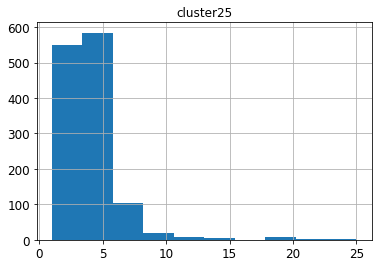

In [9]:
cluster25_df['cluster25'].value_counts().to_frame().hist()

In [10]:
# 50% Statistics
cluster50_df = pd.read_csv('../cluster50.csv', index_col="Unnamed: 0")
cluster50_df['cluster50'].value_counts()

cluster501       18
cluster50209      9
cluster5088       7
cluster5073       5
cluster50203      5
                 ..
cluster501540     1
cluster502298     1
cluster502190     1
cluster501592     1
cluster502508     1
Name: cluster50, Length: 2562, dtype: int64

In [11]:
cluster50_df['cluster50'].value_counts().value_counts()

1     1262
2      462
3      444
4      383
5        8
9        1
7        1
18       1
Name: cluster50, dtype: int64

array([[<AxesSubplot:title={'center':'cluster50'}>]], dtype=object)

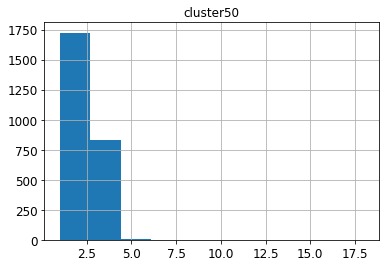

In [12]:
cluster50_df['cluster50'].value_counts().to_frame().hist()

In [13]:
# 75% Statistics
cluster75_df = pd.read_csv('../cluster75.csv', index_col="Unnamed: 0")
cluster75_df['cluster75'].value_counts()

cluster753378    7
cluster75355     4
cluster75156     4
cluster75301     4
cluster75235     4
                ..
cluster752989    1
cluster752842    1
cluster753124    1
cluster752941    1
cluster752256    1
Name: cluster75, Length: 3843, dtype: int64

In [14]:
cluster75_df['cluster75'].value_counts().value_counts()

1    2911
2     646
3     226
4      59
7       1
Name: cluster75, dtype: int64

array([[<AxesSubplot:title={'center':'cluster75'}>]], dtype=object)

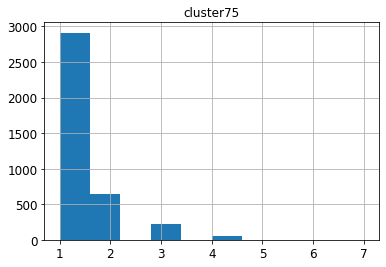

In [15]:
cluster75_df['cluster75'].value_counts().to_frame().hist()

# 4. Visualize data

In [16]:
# Zip entities and their corresponding embeddings
entities_embeddings = dict(zip(entities, model.get_embeddings(entities)))
entities_embeddings_array = np.array([i for i in entities_embeddings.values()])

In [38]:
# Project embeddings into 2D space via PCA
embeddings_2d = PCA(n_components=2).fit_transform(entities_embeddings_array)

# This function maps country to continent
def entity_to_type(entityname):
    etype = "unk"
    if entityname[17] == 'g':
        etype = "Genre"
    elif entityname[17] == 'a':
        etype = "Actor"
    elif entityname[17] == 'd':
        etype = "Director"
    return etype

entities_df = pd.DataFrame({"entities": entities,
                        "x_projection": embeddings_2d[:, 0],
                        "y_projection": embeddings_2d[:, 1],
                        "type": pd.Series(entities).apply(entity_to_type),
                        "cluster25": "cluster25" + cluster25_df['cluster25'].astype(str),
                        "cluster50": "cluster50" + cluster50_df['cluster50'].astype(str),
                        "cluster75": "cluster75" + cluster75_df['cluster75'].astype(str)})

#print(plot_df)
np.random.seed(0)

# Plot 2D embeddings
def plot_entities(in_hue):
    plt.figure(figsize=(12, 12))
    plt.title("Entities by {}".format(in_hue).capitalize())
    ax = sns.scatterplot(data=entities_df[entities_df.type!="unk"],
                         x="x_projection", y="y_projection", hue=in_hue)

genres_df = entities_df[entities_df.type=="Genre"]
# Plot 2D embeddings about genres with labels
def plot_genres(in_hue):
    #1#print(genres_df)
    plt.figure(figsize=(12, 12))
    plt.title("Genres by {}".format(in_hue).capitalize())
    ax = sns.scatterplot(data=genres_df,
                         x="x_projection", y="y_projection", hue=in_hue)
    texts = []
    for i, point in genres_df.iterrows():
        texts.append(plt.text(point['x_projection']+0.02,
                              point['y_projection']+0.01,
                              str(point["entities"])))
    adjust_text(texts)

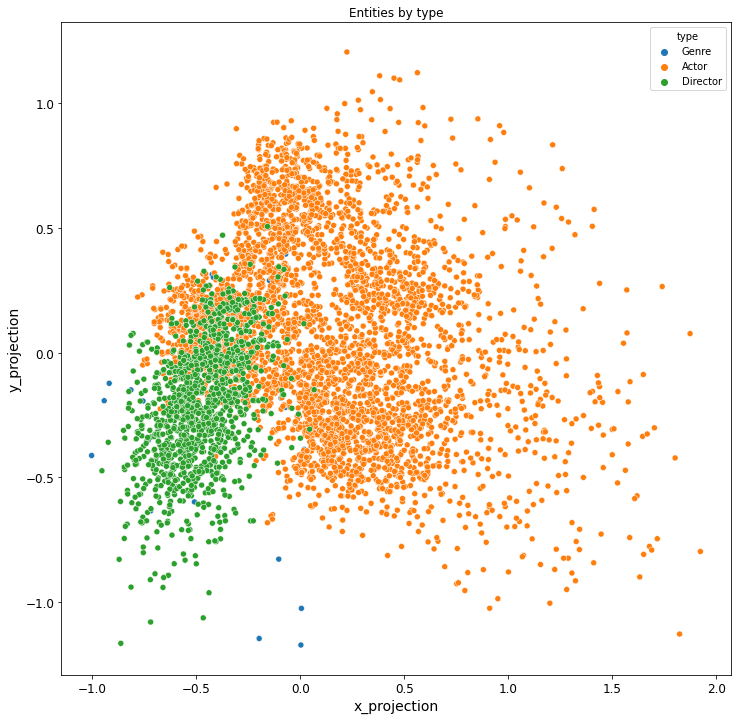

In [25]:
plot_entities("type")

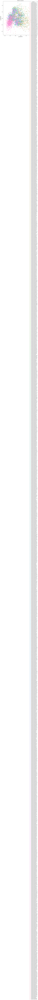

In [26]:
plot_entities("cluster25")

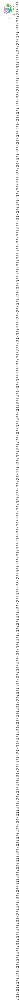

In [27]:
plot_entities("cluster50")

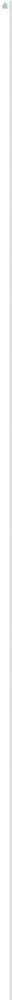

In [28]:
plot_entities("cluster75")

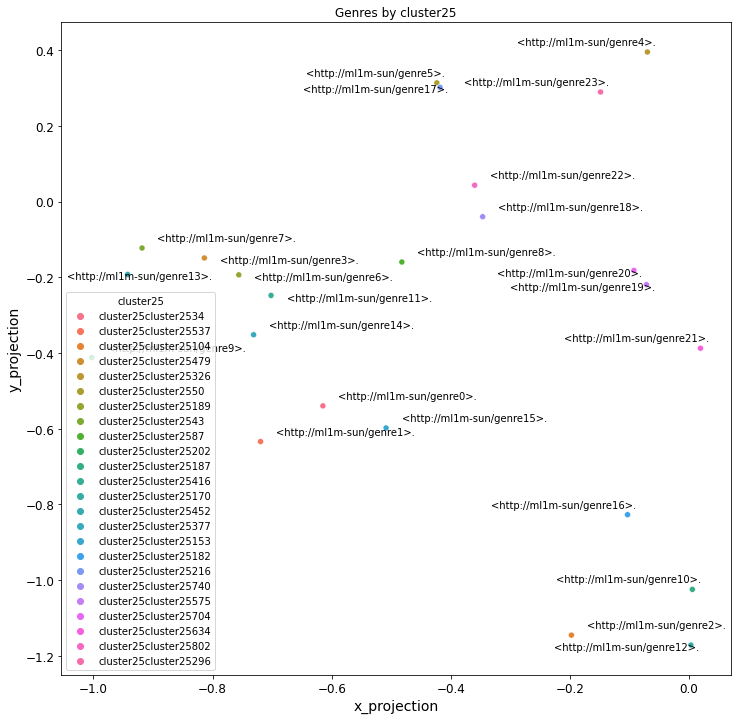

In [40]:
plot_genres("cluster25")

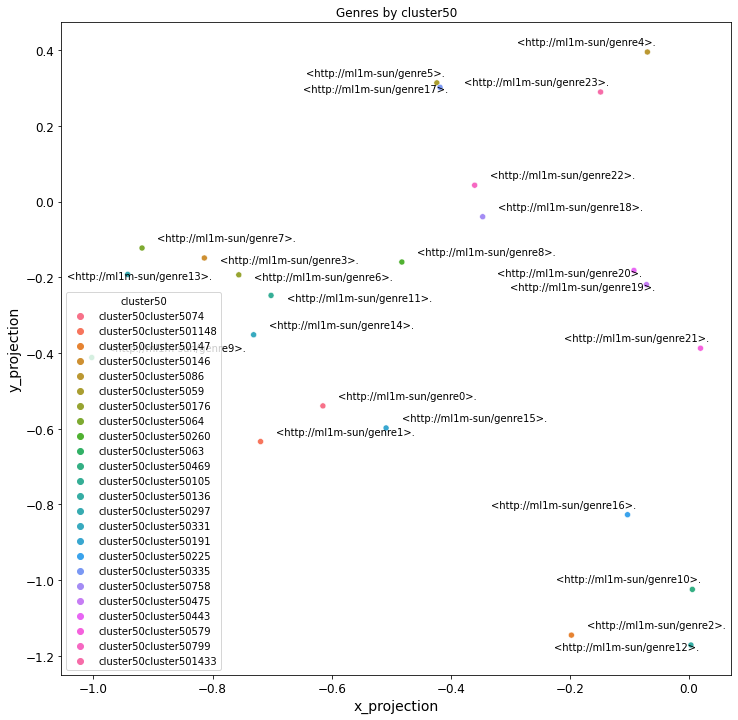

In [39]:
plot_genres("cluster50")

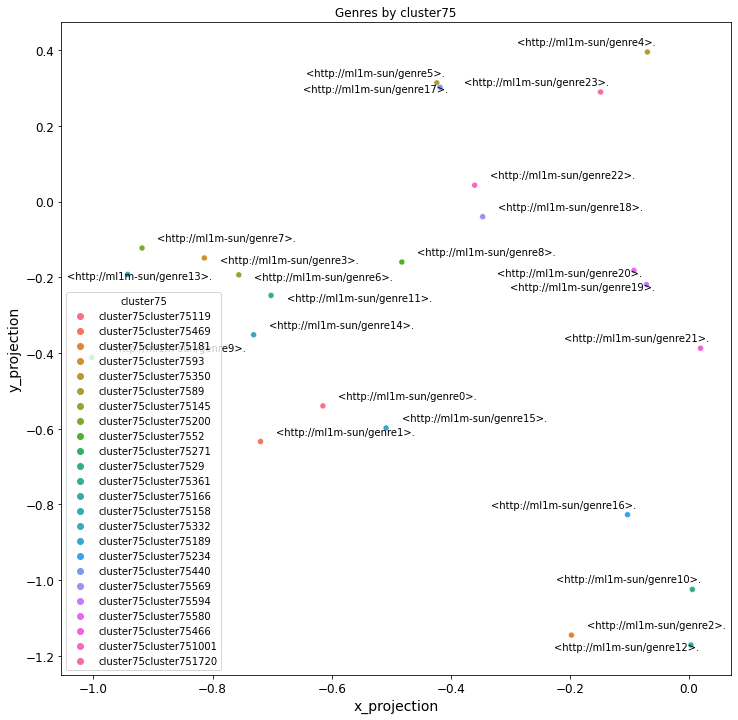

In [41]:
plot_genres("cluster75")

# 5. Conclusion

Obs.:
- 
- Entidades do mesmo tipo parecem pertercer aos mesmos grupos de cluster.
- Todos os gêneros pertencem a um cluster diferente.